In [0]:
import numpy as np

try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass
  
import tensorflow as tf



TensorFlow 2.x selected.


In [0]:
from google.colab import drive
import os
import json

drive.mount('/content/drive')
PATH = '/content/drive/My Drive/DL/'

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


# Level 5

## Define model

In [0]:
def Conv2D_Block(input_tensor , n_filters):
  x = tf.keras.layers.Conv2D(filters = n_filters , kernel_size = (3 , 3) , kernel_initializer = 'he_normal' , padding = 'same')(input_tensor)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.Activation('relu')(x)
  
  x = tf.keras.layers.Conv2D(filters = n_filters , kernel_size = (3 , 3) , kernel_initializer = 'he_normal' , padding = 'same')(x)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.Activation('relu')(x)
  
  return x


def U_Net(img_tensor , n_filters = 16):
  conv1 = Conv2D_Block(img_tensor , n_filters * 1)
  pool1 = tf.keras.layers.MaxPooling2D((2 , 2))(conv1)
  pool1 = tf.keras.layers.Dropout(0.05)(pool1)
  
  conv2 = Conv2D_Block(pool1 , n_filters * 2)
  pool2 = tf.keras.layers.MaxPooling2D((2 , 2))(conv2)
  pool2 = tf.keras.layers.Dropout(0.05)(pool2)
  
  conv3 = Conv2D_Block(pool2 , n_filters * 4)
  pool3 = tf.keras.layers.MaxPooling2D((2 , 2))(conv3)
  pool3 = tf.keras.layers.Dropout(0.05)(pool3)
  
  conv4 = Conv2D_Block(pool3 , n_filters * 8)
  pool4 = tf.keras.layers.MaxPooling2D((2 , 2))(conv4)
  pool4 = tf.keras.layers.Dropout(0.05)(pool4)
  
  conv5 = Conv2D_Block(pool4 , n_filters * 16)
  
  pool6 = tf.keras.layers.Conv2DTranspose(n_filters * 8 , (3 , 3) , (2, 2) , padding = 'same')(conv5)
  pool6 = tf.keras.layers.concatenate([pool6 , conv4])
  pool6 = tf.keras.layers.Dropout(0.05)(pool6)
  conv6 = Conv2D_Block(pool6 , n_filters * 8)
  
  pool7 = tf.keras.layers.Conv2DTranspose(n_filters * 4 , (3 , 3) , (2 , 2) , padding = 'same')(conv6)
  pool7 = tf.keras.layers.concatenate([pool7 , conv3])
  pool7 = tf.keras.layers.Dropout(0.05)(pool7)
  conv7 = Conv2D_Block(pool7 , n_filters * 4)
  
  pool8 = tf.keras.layers.Conv2DTranspose(n_filters * 2 , (3 , 3) , (2 , 2) , padding = 'same')(conv7)
  pool8 = tf.keras.layers.concatenate([pool8 , conv2])
  pool8 = tf.keras.layers.Dropout(0.05)(pool8)
  conv8 = Conv2D_Block(pool8 , n_filters * 2)
  
  pool9 = tf.keras.layers.Conv2DTranspose(n_filters * 1 , (3 , 3) , (2 , 2) , padding = 'same')(conv8)
  pool9 = tf.keras.layers.concatenate([pool9 , conv1])
  pool9 = tf.keras.layers.Dropout(0.05)(pool9)
  conv9 = Conv2D_Block(pool9 , n_filters * 1)
  
  output = tf.keras.layers.Conv2D(1 , (1 , 1) , activation = 'sigmoid')(conv9)
  
  u_net = tf.keras.Model(inputs = [img_tensor] , outputs = [output])
  
  return u_net

img_tensor = tf.keras.layers.Input((128 , 128 , 3) , name = 'img')
model = U_Net(img_tensor)

In [0]:
import keras.backend as K

smooth = 1. 
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true) 
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f * y_true_f) + K.sum(y_pred_f * y_pred_f) + smooth)

def compound_loss(y_true, y_pred):
  loss1 = tf.keras.losses.binary_crossentropy(y_true, y_pred, from_logits=True)
  loss = K.mean(1. - dice_coef(y_true, y_pred) + loss1)
  return loss

Using TensorFlow backend.


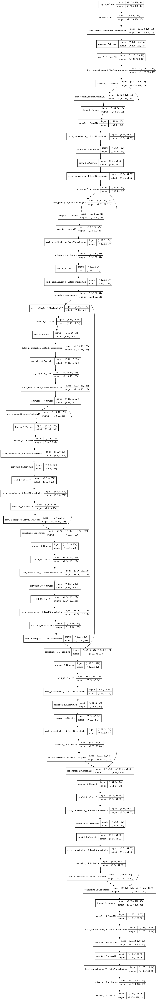

In [0]:
optimizer = tf.keras.optimizers.Adam(lr=2.5e-3, beta_1=0.9, beta_2=0.999, epsilon=1e-6)
model.compile(optimizer=optimizer, loss=compound_loss,
              metrics=[dice_coef])

tf.keras.utils.plot_model(model, show_shapes=True)

## Load model

In [0]:
import os
checkpoint_path = 'model_tumor_level5.h5' # only this file is available


checkpoint_url = "https://storage.googleapis.com/dl4cv1445/ADL/model_tumor_level5.h5"

# Download the whole slide image
if not os.path.exists(checkpoint_path):
  !curl -O $checkpoint_url

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 8619k  100 8619k    0     0  11.0M      0 --:--:-- --:--:-- --:--:-- 11.0M


In [0]:
model.load_weights('model_tumor_level5.h5')

## Prediction visualization

In [0]:
import os
dataset_path = 'dataset.zip' # only this file is available


dataset_url = "https://storage.googleapis.com/dl4cv1445/ADL/dataset.zip"

# Download the whole slide image
if not os.path.exists(dataset_path):
  !curl -O $dataset_url

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 48.7M  100 48.7M    0     0  21.2M      0  0:00:02  0:00:02 --:--:-- 21.2M


In [0]:
!unzip dataset

Archive:  dataset.zip
   creating: dataset/
   creating: dataset/dt023/
  inflating: dataset/dt023/023_35_8_mask.jpg  
  inflating: dataset/dt023/023_47_22.jpg  
  inflating: dataset/dt023/023_35_9_mask.jpg  
  inflating: dataset/dt023/023_33_12.jpg  
  inflating: dataset/dt023/023_29_8.jpg  
  inflating: dataset/dt023/023_34_0_mask.jpg  
  inflating: dataset/dt023/023_2_17.jpg  
  inflating: dataset/dt023/023_38_0.jpg  
  inflating: dataset/dt023/023_40_0.jpg  
  inflating: dataset/dt023/023_30_9.jpg  
  inflating: dataset/dt023/023_52_17.jpg  
  inflating: dataset/dt023/023_45_21_mask.jpg  
  inflating: dataset/dt023/023_45_20_mask.jpg  
  inflating: dataset/dt023/023_35_20_mask.jpg  
  inflating: dataset/dt023/023_31_17.jpg  
  inflating: dataset/dt023/023_36_12_mask.jpg  
  inflating: dataset/dt023/023_36_13_mask.jpg  
  inflating: dataset/dt023/023_32_4_mask.jpg  
  inflating: dataset/dt023/023_32_5_mask.jpg  
  inflating: dataset/dt023/023_31_16.jpg  
  inflating: dataset/dt023/0

In [0]:
IMG_SIZE = 128

def load_and_preprocess_image(path_img, path_label):
  img_tensor = tf.io.read_file(path_img)
  input_image = tf.image.decode_jpeg(img_tensor, channels=3)
  input_image = tf.image.resize(input_image, [IMG_SIZE, IMG_SIZE])
  label_tensor = tf.io.read_file(path_label)
  input_mask = tf.image.decode_jpeg(label_tensor, channels=1)
  input_mask = tf.image.resize(input_mask, [IMG_SIZE, IMG_SIZE])
  
  input_image /= 255.0
  input_mask /= 255.0
  return input_image, input_mask

### 091

#### True mask

In [0]:
from __future__ import absolute_import, division, print_function, unicode_literals

from IPython.display import clear_output
import matplotlib.pyplot as plt

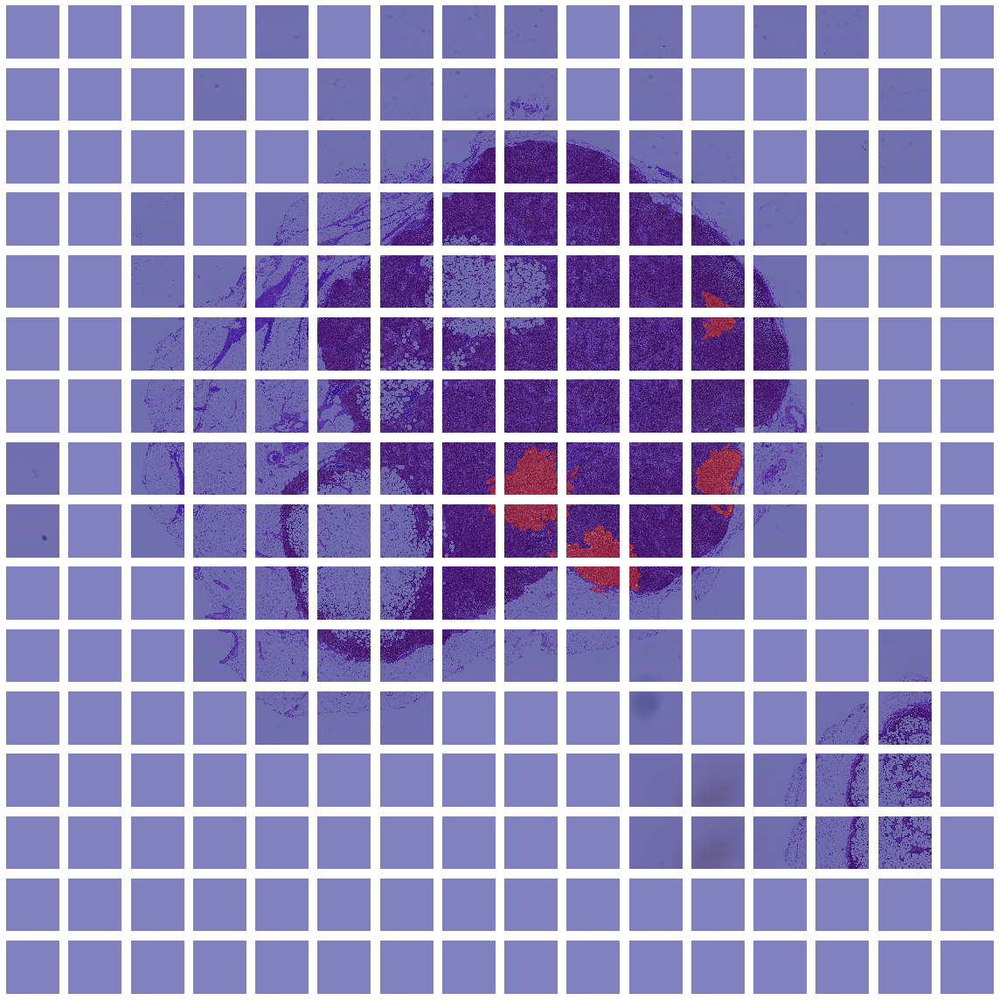

In [0]:
mm = 16
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, mm, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(mm):
    try:
      img_path = "dataset/dt091/091_" + str(i) + "_" + str(j) + ".jpg"
      label_path = "dataset/dt091/091_" + str(i) + "_" + str(j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.show()

#### Predicted mask

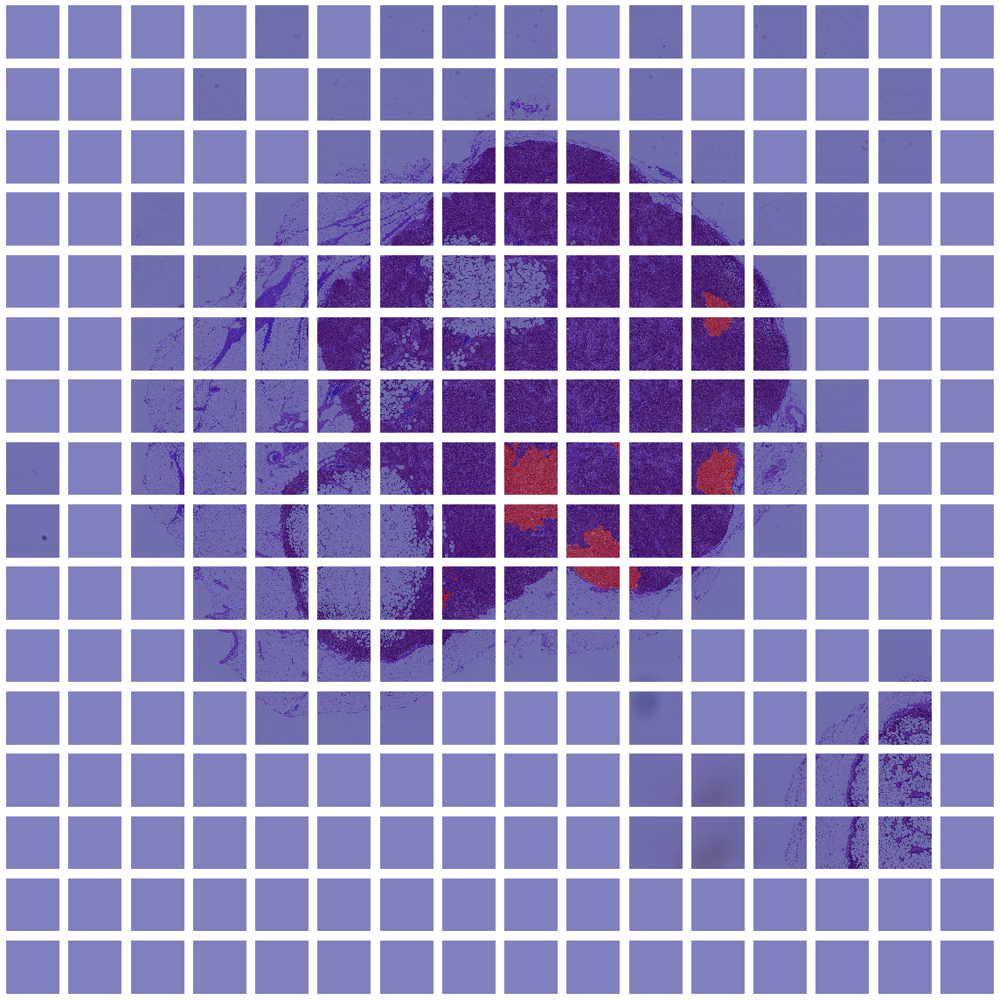

In [0]:
mm = 16
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, mm, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(mm):
    try:
      img_path = "dataset/dt091/091_" + str(i) + "_" + str(j) + ".jpg"
      label_path = "dataset/dt091/091_" + str(i) + "_" + str(j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    pred_mask = model.predict(image)
    pred_mask = pred_mask[0, ...]
    pred_mask = pred_mask[..., 0]
    pred_mask = np.where(pred_mask>=0.5, 1.0, 0.0)
    assert(pred_mask.shape == (128,128))

    mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.show()

#### Accuracy

In [0]:
def recall(mask_image, heatmap):
  TP = 0
  FN = 0
  FP = 0
  TN = 0


  for i in range(heatmap.shape[0]):
    for j in range(heatmap.shape[1]):
      if mask_image[i][j] >= 0.5 and heatmap[i][j] >= 0.5:
        TP += 1
      elif mask_image[i][j] >= 0.5 and heatmap[i][j] < 0.5:
        FN += 1
      elif mask_image[i][j] < 0.5 and heatmap[i][j] >= 0.5:
        FP += 1
      elif mask_image[i][j] < 0.5 and heatmap[i][j] < 0.5:
        TN += 1
  return [TP, FN]

  

In [0]:
mm = 16
import cv2
WIDTH = 128
HEIGHT = 128



tp_all = []
fn_all = []
for i in range(mm):
  for j in range(mm):
    try:
      img_path = "dataset/dt091/091_" + str(i) + "_" + str(j) + ".jpg"
      label_path = "dataset/dt091/091_" + str(i) + "_" + str(j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    pred_mask = model.predict(image)
    pred_mask = pred_mask[0, ...]
    pred_mask = pred_mask[..., 0]
    pred_mask = np.where(pred_mask>=0.5, 1.0, 0.0)
    assert(pred_mask.shape == (128,128))
    temp = recall(mask_img, pred_mask)
    tp_all.append(temp[0])
    fn_all.append(temp[1])
    


print('recall: ', np.sum(tp_all) * 100.0 / (np.sum(fn_all) + np.sum(tp_all)) )

### 016

#### True mask

In [0]:
from __future__ import absolute_import, division, print_function, unicode_literals

from IPython.display import clear_output
import matplotlib.pyplot as plt

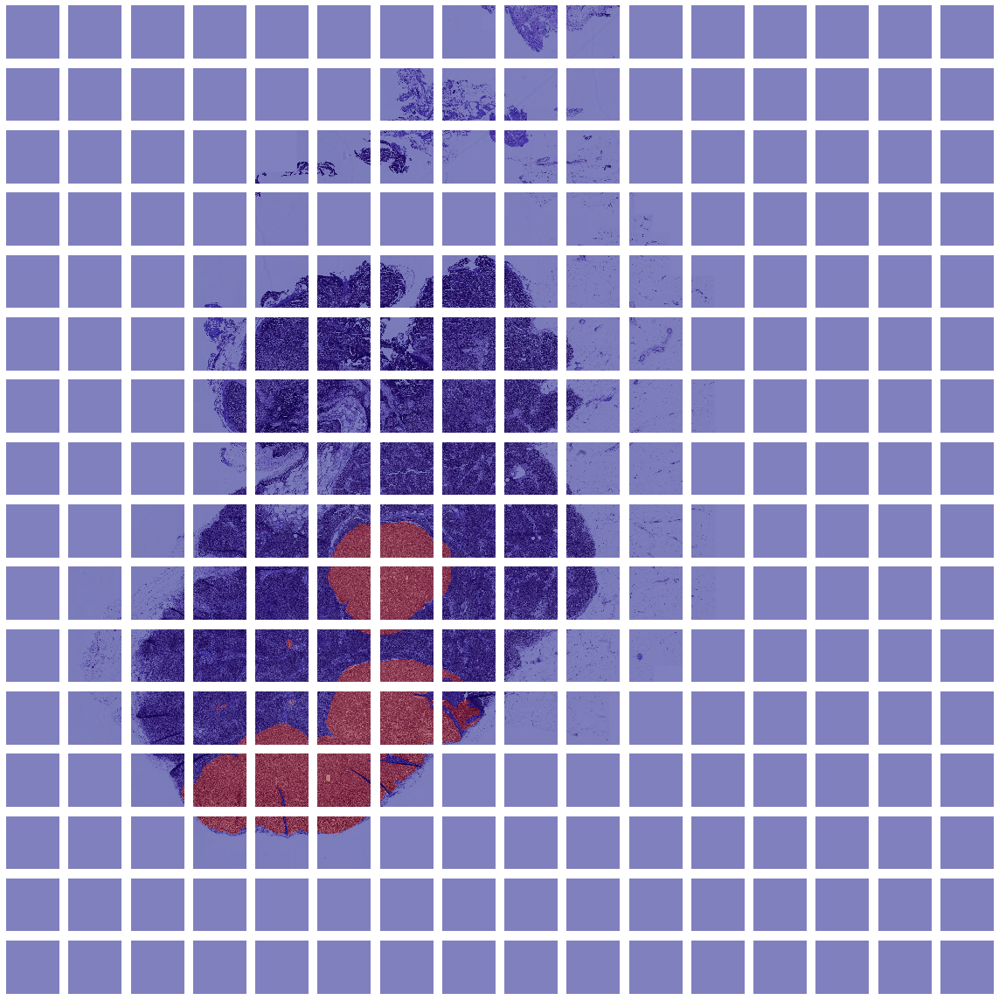

In [0]:
mm = 16
nn = 16
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dataset/dt016/016_" + str(28+i) + "_" + str(4+j) + ".jpg"
      label_path = "dataset/dt016/016_" + str(28+i) + "_" + str(4+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.show()

#### Predicted mask

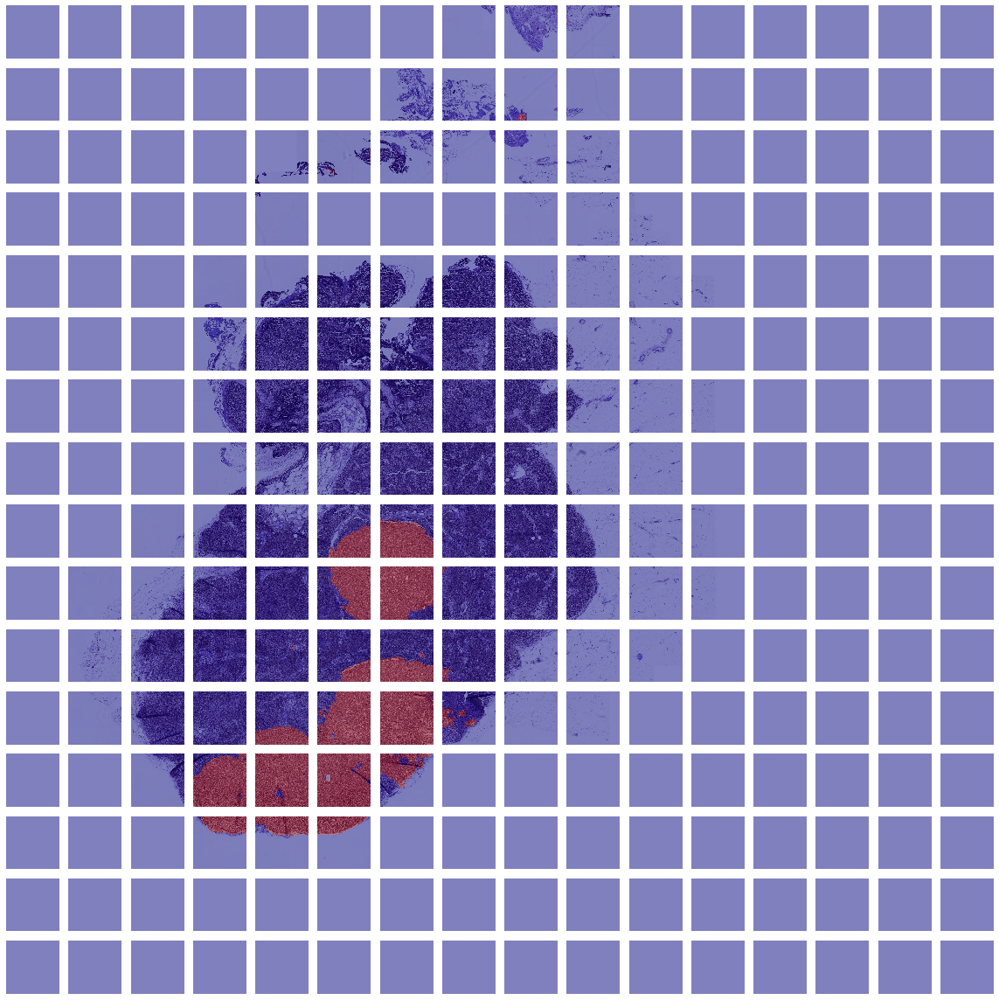

In [0]:
mm = 16
nn = 16
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dataset/dt016/016_" + str(28+i) + "_" + str(4+j) + ".jpg"
      label_path = "dataset/dt016/016_" + str(28+i) + "_" + str(4+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    pred_mask = model.predict(image)
    pred_mask = pred_mask[0, ...]
    pred_mask = pred_mask[..., 0]
    pred_mask = np.where(pred_mask>=0.5, 1.0, 0.0)
    assert(pred_mask.shape == (128,128))

    mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.show()

#### Accuracy

In [0]:
mm = 16
import cv2
WIDTH = 128
HEIGHT = 128



dice_co = []
for i in range(mm):
  for j in range(mm):
    try:
      img_path = "dataset/dt016/016_" + str(28+i) + "_" + str(4+j) + ".jpg"
      label_path = "dataset/dt016/016_" + str(28+i) + "_" + str(4+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    pred_mask = model.predict(image)
    pred_mask = pred_mask[0, ...]
    pred_mask = pred_mask[..., 0]
    pred_mask = np.where(pred_mask>=0.5, 1.0, 0.0)
    assert(pred_mask.shape == (128,128))
    dice_co.append(dice_coef(tf.dtypes.cast(mask_img, tf.float32), tf.dtypes.cast(pred_mask, tf.float32)))
    


print('Dice coefficient: ', np.mean(dice_co) * 100.0)

Dice coefficient:  95.80808281898499


### 096

#### True mask

In [0]:
from __future__ import absolute_import, division, print_function, unicode_literals

from IPython.display import clear_output
import matplotlib.pyplot as plt

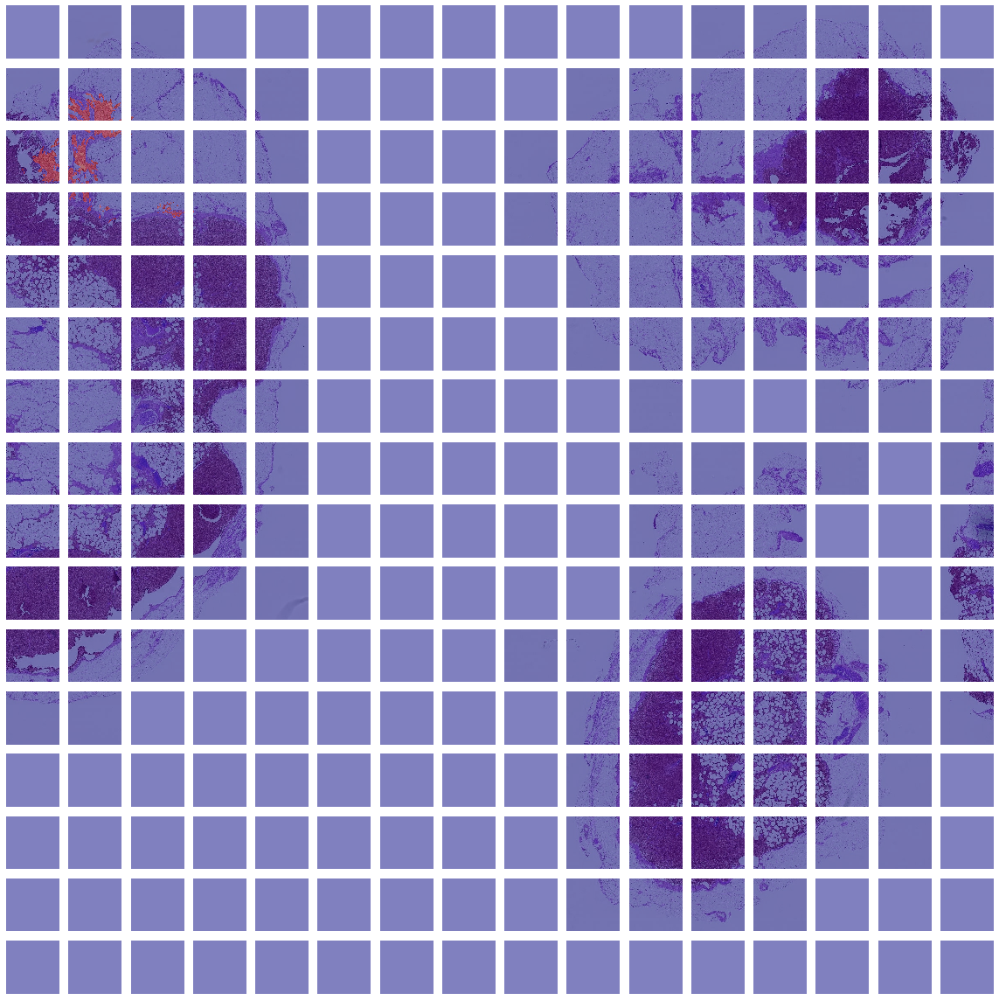

In [0]:
mm = 16
nn = 16
pred_index = '096'
x_offset = 1
y_offset = 9
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dataset/dt"+pred_index+"/"+pred_index+"_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "dataset/dt"+pred_index+"/"+pred_index+"_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.show()

#### Predicted mask

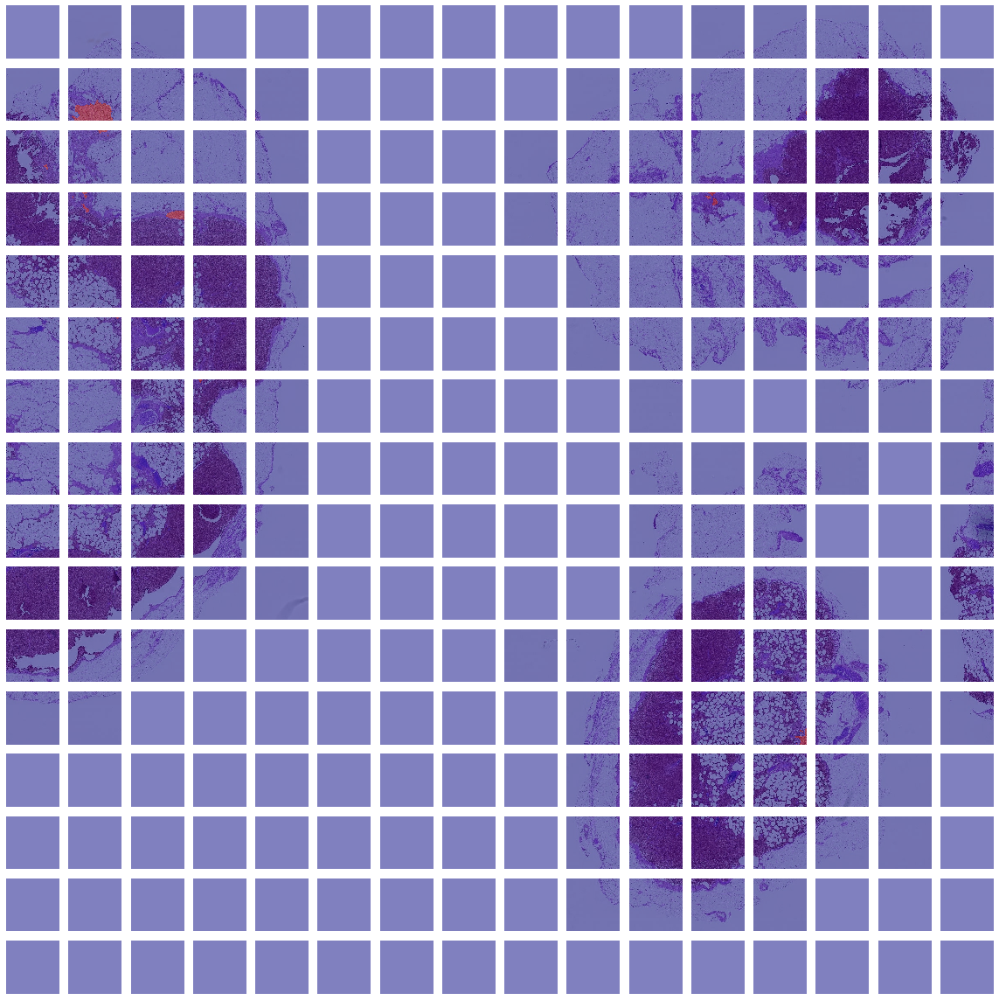

In [0]:
mm = 16
nn = 16
pred_index = '096'
x_offset = 1
y_offset = 9
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dataset/dt"+pred_index+"/"+pred_index+"_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "dataset/dt"+pred_index+"/"+pred_index+"_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    pred_mask = model.predict(image)
    pred_mask = pred_mask[0, ...]
    pred_mask = pred_mask[..., 0]
    pred_mask = np.where(pred_mask>=0.5, 1.0, 0.0)
    assert(pred_mask.shape == (128,128))

    mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.show()

#### Accuracy

In [0]:
mm = 16
nn = 16
pred_index = '096'
x_offset = 1
y_offset = 9
import cv2
WIDTH = 128
HEIGHT = 128



dice_co = []
for i in range(mm):
  for j in range(mm):
    try:
      img_path = "dataset/dt"+pred_index+"/"+pred_index+"_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "dataset/dt"+pred_index+"/"+pred_index+"_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    pred_mask = model.predict(image)
    pred_mask = pred_mask[0, ...]
    pred_mask = pred_mask[..., 0]
    pred_mask = np.where(pred_mask>=0.5, 1.0, 0.0)
    assert(pred_mask.shape == (128,128))
    dice_co.append(dice_coef(tf.dtypes.cast(mask_img, tf.float32), tf.dtypes.cast(pred_mask, tf.float32)))
    


print('Dice coefficient: ', np.mean(dice_co) * 100.0)

Dice coefficient:  94.80155110359192


### 001

#### True mask

In [0]:
from __future__ import absolute_import, division, print_function, unicode_literals

from IPython.display import clear_output
import matplotlib.pyplot as plt

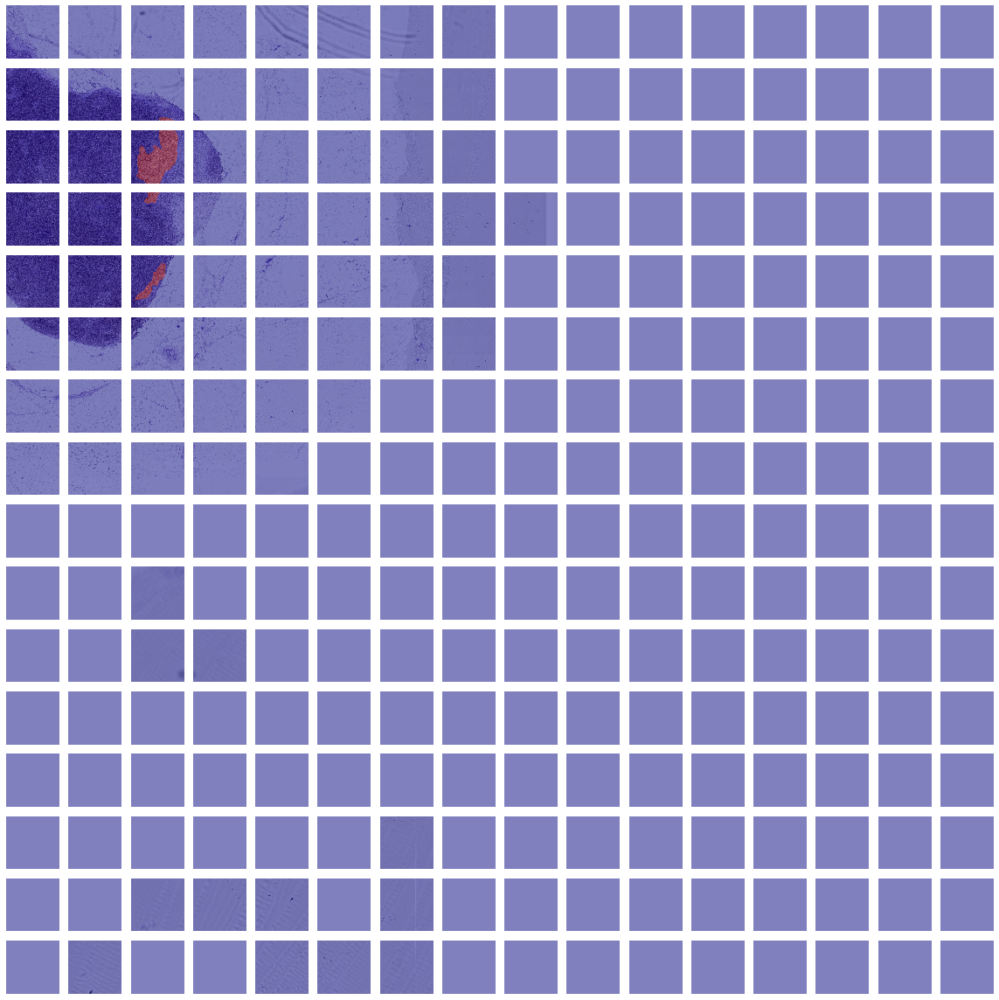

In [0]:
mm = 16
nn = 16
x_offset = 28
y_offset = 15
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dataset/dt001/001_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "dataset/dt001/001_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.show()

#### Predicted mask

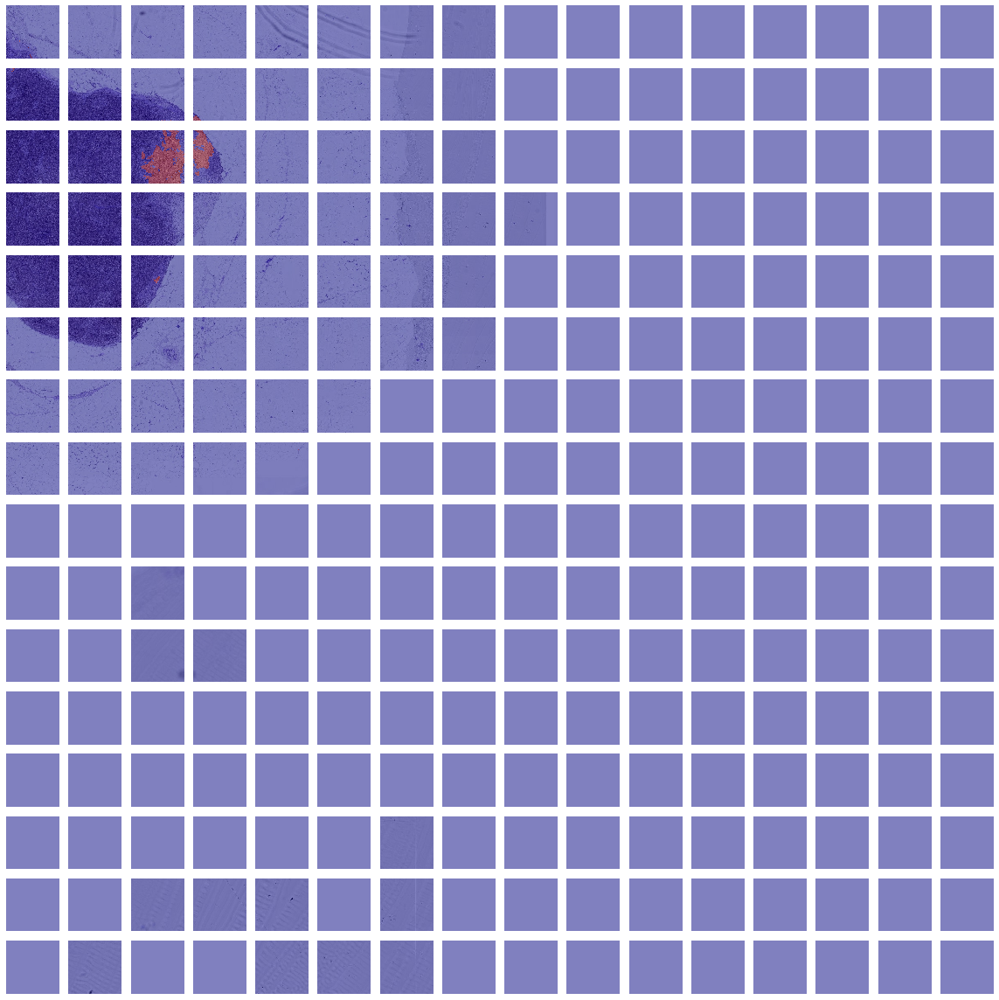

In [0]:
mm = 16
nn = 16
x_offset = 28
y_offset = 15
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dataset/dt001/001_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "dataset/dt001/001_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    pred_mask = model.predict(image)
    pred_mask = pred_mask[0, ...]
    pred_mask = pred_mask[..., 0]
    pred_mask = np.where(pred_mask>=0.5, 1.0, 0.0)
    assert(pred_mask.shape == (128,128))

    mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.show()

#### Accuracy

In [0]:
mm = 16
nn = 16
x_offset = 28
y_offset = 15
import cv2
WIDTH = 128
HEIGHT = 128



dice_co = []
for i in range(mm):
  for j in range(mm):
    try:
      img_path = "dataset/dt001/001_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "dataset/dt001/001_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    pred_mask = model.predict(image)
    pred_mask = pred_mask[0, ...]
    pred_mask = pred_mask[..., 0]
    pred_mask = np.where(pred_mask>=0.5, 1.0, 0.0)
    assert(pred_mask.shape == (128,128))
    dice_co.append(dice_coef(tf.dtypes.cast(mask_img, tf.float32), tf.dtypes.cast(pred_mask, tf.float32)))
    


print('Dice coefficient: ', np.mean(dice_co) * 100.0)

Dice coefficient:  98.57977628707886


# Level 3

## Define model

In [0]:
class DataGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, dt_type, labels, batch_size=32, dim=(128,128), n_channels=3,
                 n_classes=2, shuffle=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.labels = labels
        self.dt_type = dt_type
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(10000/ self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        if self.dt_type == 'train':
            # Generate data
            IDs = []
            for i in range(self.batch_size//2):
              IDs.append(random.choice(pos_train))
              IDs.append(random.choice(neg_train))
            shuffle(IDs)
        elif self.dt_type == 'validation':
            IDs = []
            for i in range(self.batch_size//2):
              IDs.append(random.choice(pos_val))
              IDs.append(random.choice(neg_val))
            shuffle(IDs)

        # Generate data
        X, y = self.__data_generation(IDs)

        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, IDs):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        channels = 1
        X = np.empty((self.batch_size, *self.dim, self.n_channels))
        y = np.empty((self.batch_size), dtype=int)

        for i, ID in enumerate(IDs):
            # print("ID: ", ID)
            # Store sample
            X[i,] = Image.open(r'dataset/dt'+ID.split('_')[0] + '/' + ID + '.jpg')
            # convert image to numpy array
            X[i,] = asarray(X[i,])
            if self.dt_type == 'train':
                # Data augmentation
                ro = random.randint(1, 5)
                if ro == 1:
                  X[i,] = np.rot90(X[i,])
                if ro == 2:
                  X[i,] = np.fliplr(X[i,])
                if ro == 3:
                  X[i,] = np.flipud(X[i,])
                if ro == 4:
                  X[i,] = np.rot90(X[i,], 2)

            X[i,] /= 255.0

            # Store class
            y[i] = self.labels[ID]
        return X, y

In [0]:
import tensorflow_datasets as tfds
tfds.disable_progress_bar()

from IPython.display import clear_output
import matplotlib.pyplot as plt

conv_base = tf.keras.applications.DenseNet201(weights='imagenet',
                    include_top=False,
                    input_shape=(128, 128, 3))

base_model = conv_base

74842112/74836368 [==============================] - 3s 0us/step


In [0]:
# METRICS = [
#       tf.keras.metrics.TruePositives(name='tp'),
#       tf.keras.metrics.FalsePositives(name='fp'),
#       tf.keras.metrics.TrueNegatives(name='tn'),
#       tf.keras.metrics.FalseNegatives(name='fn'), 
#       tf.keras.metrics.BinaryAccuracy(name='accuracy'),
#       tf.keras.metrics.Precision(name='precision'),
#       tf.keras.metrics.Recall(name='recall'),
#       tf.keras.metrics.AUC(name='auc'),
# ]

In [0]:
from __future__ import absolute_import, division, print_function, unicode_literals
import keras.backend as K


global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
prediction_layer = tf.keras.layers.Dense(1, activation='sigmoid')
# build a new model reusing the pretrained base
model = tf.keras.Sequential([
  base_model,
  tf.keras.layers.Conv2D(256, (1,1), activation='relu'),
  tf.keras.layers.Flatten(input_shape=(4,4,512)), 
  tf.keras.layers.Dense(
          64, activation='relu',
          input_shape=(4, 4, 512),
          kernel_initializer=tf.keras.initializers.he_normal(),
          bias_initializer='zeros'),
  # tf.keras.layers.Dropout(0.5),
  tf.keras.layers.Dense(
          16, activation='relu',
          kernel_initializer=tf.keras.initializers.he_normal(),
          bias_initializer='zeros'),
  tf.keras.layers.Dense(1, activation='sigmoid')
])



Using TensorFlow backend.


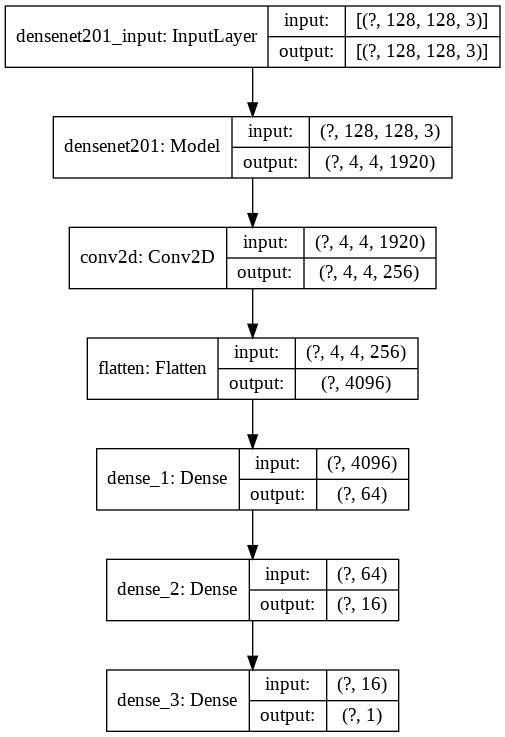

In [0]:
# rmsprop = RMSprop(lr=0.1)
# adam = tf.keras.optimizers.Adam(lr=0.01)
sgd = tf.keras.optimizers.SGD(learning_rate=1e-7, momentum=0.9)
def loss_fn(y_true, y_pred):
  loss = tf.keras.losses.binary_crossentropy(y_true, y_pred, from_logits=True)
  return loss

model.compile(optimizer=sgd, loss=loss_fn,
              metrics=['accuracy'])

tf.keras.utils.plot_model(model, show_shapes=True)

## Load model

In [0]:
import os
checkpoint_path = 'model_tumor_level3.h5' # only this file is available


checkpoint_url = "https://storage.googleapis.com/dl4cv1445/ADL/model_tumor_level3.h5"

# Download the whole slide image
if not os.path.exists(checkpoint_path):
  !curl -O $checkpoint_url

In [0]:
model.load_weights('model_tumor_level3.h5')

## Prediction visualization

In [0]:
IMG_SIZE = 128
def load_and_preprocess_image_test(path_img, path_label):
  img_tensor = tf.io.read_file(path_img)
  input_image = tf.image.decode_jpeg(img_tensor, channels=3)
  input_image = tf.image.resize(input_image, [IMG_SIZE, IMG_SIZE])

  label_tensor = tf.io.read_file(path_label)
  # input_mask = tf.image.decode_image(label_tensor)
  input_mask = tf.image.decode_jpeg(label_tensor, channels=1)
  input_mask = tf.image.resize(input_mask, [IMG_SIZE, IMG_SIZE])
  
  input_image /= 255.0
  # input_mask /= 255.0
  return input_image, input_mask

### 001

In [0]:
import os
dataset_path = 'level3_001.zip' # only this file is available


dataset_url = "https://storage.googleapis.com/dl4cv1445/level3_001.zip"

# Download the whole slide image
if not os.path.exists(dataset_path):
  !curl -O $dataset_url


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 63.6M  100 63.6M    0     0  49.5M      0  0:00:01  0:00:01 --:--:-- 49.5M


In [0]:
!unzip level3_001.zip

Archive:  level3_001.zip
   creating: level3_001/
  inflating: level3_001/.DS_Store    
   creating: level3_001/dt/
  inflating: level3_001/dt/001_115_20.jpg  
  inflating: level3_001/dt/001_95_6_mask.jpg  
  inflating: level3_001/dt/001_114_36_mask.jpg  
  inflating: level3_001/dt/001_180_86_mask.jpg  
  inflating: level3_001/dt/001_185_40_mask.jpg  
  inflating: level3_001/dt/001_72_47.jpg  
  inflating: level3_001/dt/001_80_53_mask.jpg  
  inflating: level3_001/dt/001_108_71.jpg  
  inflating: level3_001/dt/001_130_7_mask.jpg  
  inflating: level3_001/dt/001_181_28_mask.jpg  
  inflating: level3_001/dt/001_53_89.jpg  
  inflating: level3_001/dt/001_11_25_mask.jpg  
  inflating: level3_001/dt/001_197_37.jpg  
  inflating: level3_001/dt/001_134_66_mask.jpg  
  inflating: level3_001/dt/001_67_42_mask.jpg  
  inflating: level3_001/dt/001_112_29.jpg  
  inflating: level3_001/dt/001_20_67.jpg  
  inflating: level3_001/dt/001_66_32.jpg  
  inflating: level3_001/dt/001_185_41_mask.jpg  
  i

#### True mask 001

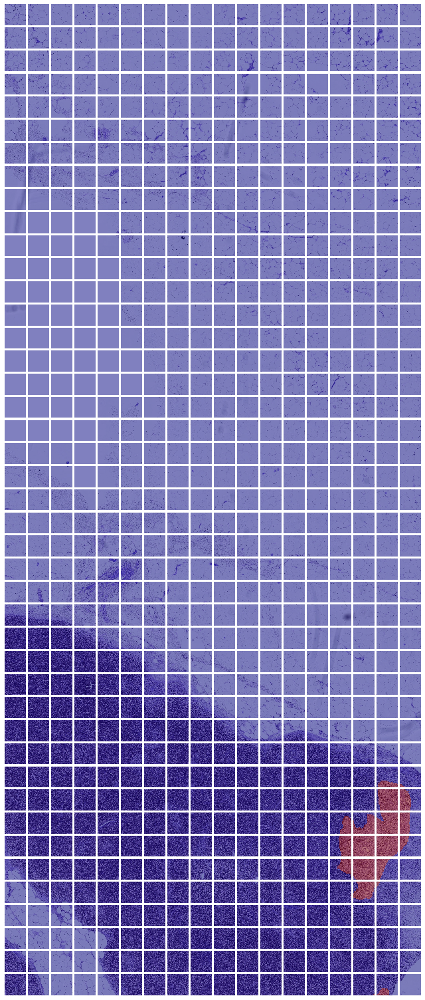

In [0]:
mm = 43
nn = 18
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(18//2,43//2))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dt/001_" + str(43*2+i) + "_" + str(18*3+j) + ".jpg"
      label_path = "dt/001_" + str(43*2+i) + "_" + str(18*3+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    # img_path = "dt/001_" + str(i) + "_" + str(j) + ".jpg"
    # label_path = "dt/001_" + str(i) + "_" + str(j) + "_mask.jpg"
    # slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0.0, vmax=1.0, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    # mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Predicted mask 001

In [0]:
mm = 43
nn = 18
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(18//2,43//2))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_001/dt/001_" + str(43*2+i) + "_" + str(18*3+j) + ".jpg"
      label_path = "level3_001/dt/001_" + str(43*2+i) + "_" + str(18*3+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] >0.5:
      mask_img = np.ones((128,128,1))
    else:
      mask_img = np.zeros((128,128,1))
    mask_img = mask_img[...,0]

    # mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Accuracy

In [0]:
def find_cancer_pixels(image):
    indices = np.where(image>0)
    # print(len(indices[0]))
    # percent_cancer = len(indices[0]) / float(image.shape[0] * image.shape[0]) * 100
    if len(indices[0]) > 0:
      return True
    else:
      return False


overall = 0
overlap = 0

mm = 43
nn = 18
import cv2

WIDTH = 128
HEIGHT = 128


for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_001/dt/001_" + str(43*2+i) + "_" + str(18*3+j) + ".jpg"
      label_path = "level3_001/dt/001_" + str(43*2+i) + "_" + str(18*3+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5 and find_cancer_pixels(mask_img):
      overlap += 1
    if pred_mask[0][0] > 0.5 or find_cancer_pixels(mask_img):
      overall += 1
    mask_img = mask_img[...,0]

    mask_img = mask_img * 255.0

print('Accuracy: ', overlap * 100.0 / overall)

Accuracy:  75.0


### 096

In [0]:
import os
dataset_path = 'level3_096.zip' # only this file is available


dataset_url = "https://storage.googleapis.com/dl4cv1445/level3_096.zip"

# Download the whole slide image
if not os.path.exists(dataset_path):
  !curl -O $dataset_url


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 38.9M  100 38.9M    0     0  32.5M      0  0:00:01  0:00:01 --:--:-- 32.5M


In [0]:
!unzip level3_096.zip

Archive:  level3_096.zip
   creating: level3_096/
  inflating: level3_096/.DS_Store    
   creating: level3_096/dt096/
  inflating: level3_096/dt096/096_36_19.jpg  
  inflating: level3_096/dt096/096_51_82.jpg  
  inflating: level3_096/dt096/096_38_34.jpg  
  inflating: level3_096/dt096/096_14_7_mask.jpg  
  inflating: level3_096/dt096/096_10_90_mask.jpg  
  inflating: level3_096/dt096/096_49_10_mask.jpg  
  inflating: level3_096/dt096/096_44_106.jpg  
  inflating: level3_096/dt096/096_56_9_mask.jpg  
  inflating: level3_096/dt096/096_44_112.jpg  
  inflating: level3_096/dt096/096_14_6_mask.jpg  
  inflating: level3_096/dt096/096_38_20.jpg  
  inflating: level3_096/dt096/096_56_8_mask.jpg  
  inflating: level3_096/dt096/096_49_11_mask.jpg  
  inflating: level3_096/dt096/096_22_78.jpg  
  inflating: level3_096/dt096/096_10_91_mask.jpg  
  inflating: level3_096/dt096/096_22_50.jpg  
  inflating: level3_096/dt096/096_26_54_mask.jpg  
  inflating: level3_096/dt096/096_7_83_mask.jpg  
  infl

#### True mask 096

In [0]:
mm = 16
nn = 16
import cv2
WIDTH = 128
HEIGHT = 128
x_offset = 6
y_offset = 37

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_096/dt096/096_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "level3_096/dt096/096_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    # img_path = "dt/001_" + str(i) + "_" + str(j) + ".jpg"
    # label_path = "dt/001_" + str(i) + "_" + str(j) + "_mask.jpg"
    # slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0.0, vmax=1.0, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    # mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Predicted mask 096

In [0]:
mm = 16
nn = 16
import cv2
WIDTH = 128
HEIGHT = 128
x_offset = 6
y_offset = 37

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_096/dt096/096_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "level3_096/dt096/096_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] >0.5:
      mask_img = np.ones((128,128,1))
    else:
      mask_img = np.zeros((128,128,1))
    mask_img = mask_img[...,0]

    # mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Accuracy

In [0]:
def find_cancer_pixels(image):
    indices = np.where(image>0)
    # print(len(indices[0]))
    # percent_cancer = len(indices[0]) / float(image.shape[0] * image.shape[0]) * 100
    if len(indices[0]) > 0:
      return True
    else:
      return False


overall = 0
overlap = 0

mm = 16
nn = 16
import cv2
x_offset = 6
y_offset = 37

WIDTH = 128
HEIGHT = 128


for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_096/dt096/096_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "level3_096/dt096/096_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5 and find_cancer_pixels(mask_img):
      overlap += 1
    if pred_mask[0][0] > 0.5 or find_cancer_pixels(mask_img):
      overall += 1
    mask_img = mask_img[...,0]

    mask_img = mask_img * 255.0

print('Accuracy: ', overlap * 100.0 / overall)

Accuracy:  74.50980392156863


### 091

In [0]:
import os
dataset_path = 'level3.zip' # only this file is available


dataset_url = "https://storage.googleapis.com/dl4cv1445/level3.zip"

# Download the whole slide image
if not os.path.exists(dataset_path):
  !curl -O $dataset_url


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 16.1M  100 16.1M    0     0  17.3M      0 --:--:-- --:--:-- --:--:-- 17.3M


In [0]:
!unzip level3.zip

#### True mask 091

In [0]:
mm = 48
nn = 48
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3/dt091/091_" + str(i) + "_" + str(15+j) + ".jpg"
      label_path = "level3/dt091/091_" + str(i) + "_" + str(15+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    # img_path = "dt/001_" + str(i) + "_" + str(j) + ".jpg"
    # label_path = "dt/001_" + str(i) + "_" + str(j) + "_mask.jpg"
    # slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0.0, vmax=1.0, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    # mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Predicted mask 091

In [0]:
mm = 48
nn = 48
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3/dt091/091_" + str(i) + "_" + str(15+j) + ".jpg"
      label_path = "level3/dt091/091_" + str(i) + "_" + str(15+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5:
      mask_img = np.ones((128,128,1))
    else:
      mask_img = np.zeros((128,128,1))
    mask_img = mask_img[...,0]

    # mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Accuracy

In [0]:
def find_cancer_pixels(image):
    indices = np.where(image>0)
    # print(len(indices[0]))
    # percent_cancer = len(indices[0]) / float(image.shape[0] * image.shape[0]) * 100
    if len(indices[0]) > 0:
      return True
    else:
      return False


overall = 0
overlap = 0

mm = 48
nn = 48
import cv2

WIDTH = 128
HEIGHT = 128


for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3/dt091/091_" + str(i) + "_" + str(15+j) + ".jpg"
      label_path = "level3/dt091/091_" + str(i) + "_" + str(15+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5 and find_cancer_pixels(mask_img):
      overlap += 1
    if pred_mask[0][0] > 0.5 or find_cancer_pixels(mask_img):
      overall += 1
    mask_img = mask_img[...,0]

    mask_img = mask_img * 255.0

print('Accuracy: ', overlap * 100.0 / overall)

Accuracy:  83.0


### 016

In [0]:
import os
dataset_path = 'level3_016.zip' # only this file is available


dataset_url = "https://storage.googleapis.com/dl4cv1445/level3_016.zip"

# Download the whole slide image
if not os.path.exists(dataset_path):
  !curl -O $dataset_url


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 25.2M  100 25.2M    0     0  24.6M      0  0:00:01  0:00:01 --:--:-- 24.6M


In [0]:
!unzip level3_016.zip

#### True mask 016

In [0]:
mm = 40
nn = 40
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + ".jpg"
      label_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0.0, vmax=1.0, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    # mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Predicted mask 016

In [0]:
mm = 40
nn = 40
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + ".jpg"
      label_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5:
      mask_img = np.ones((128,128,1))
    else:
      mask_img = np.zeros((128,128,1))
    mask_img = mask_img[...,0]

    # mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Accuracy

In [0]:
def find_cancer_pixels(image):
    indices = np.where(image>0)
    # print(len(indices[0]))
    # percent_cancer = len(indices[0]) / float(image.shape[0] * image.shape[0]) * 100
    if len(indices[0]) > 0:
      return True
    else:
      return False


overall = 0
overlap = 0

mm = 40
nn = 40
import cv2

WIDTH = 128
HEIGHT = 128


for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + ".jpg"
      label_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5 and find_cancer_pixels(mask_img):
      overlap += 1
    if pred_mask[0][0] > 0.5 or find_cancer_pixels(mask_img):
      overall += 1
    mask_img = mask_img[...,0]

    mask_img = mask_img * 255.0

print('Accuracy: ', overlap * 100.0 / overall)

Accuracy:  63.55140186915888


# Level 1

## Define model

In [0]:
"""## Define model"""

import random
from random import shuffle
from random import sample
from PIL import Image
# labels = {'id-1': 0, 'id-2': 1, 'id-3': 2, 'id-4': 1}
class DataGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, dt_type, labels, batch_size=32, dim=(128,128), n_channels=3,
                 n_classes=2, shuffle=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.labels = labels
        self.dt_type = dt_type
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(10000/ self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate data
        X, y = self.__data_generation('00')

        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        # self.indexes = np.arange(len(self.list_IDs))
        # if self.shuffle == True:
        #     np.random.shuffle(self.indexes)
        import gc
        gc.collect()

    def __data_generation(self, I):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        if self.dt_type == 'train':
            # Generate data
            IDs = []
            for i in range(self.batch_size//2):
              IDs.append(random.choice(pos_train))
              IDs.append(random.choice(neg_train))
            shuffle(IDs)
        elif self.dt_type == 'validation':
            IDs = []
            for i in range(self.batch_size//2):
              IDs.append(random.choice(pos_val))
              IDs.append(random.choice(neg_val))
            shuffle(IDs)
        # Initialization
        channels = 1
        X = np.empty((self.batch_size, *self.dim, self.n_channels))
        y = np.empty((self.batch_size), dtype=int)

        for i, ID in enumerate(IDs):
            # print("ID: ", ID)
            # Store sample
            X[i,] = Image.open(r'dt'+ID.split('_')[0] + '/' + ID + '.jpg')
            # convert image to numpy array
            X[i,] = asarray(X[i,])
            if self.dt_type == 'train':
                # Data augmentation
                ro = random.randint(1, 5)
                if ro == 1:
                  X[i,] = np.rot90(X[i,])
                if ro == 2:
                  X[i,] = np.fliplr(X[i,])
                if ro == 3:
                  X[i,] = np.flipud(X[i,])
                if ro == 4:
                  X[i,] = np.rot90(X[i,], 2)

            X[i,] /= 255.0

            # Store class
            y[i] = self.labels[ID]
        return X, y

In [0]:

import tensorflow_datasets as tfds
tfds.disable_progress_bar()

from IPython.display import clear_output
import matplotlib.pyplot as plt

conv_base = tf.keras.applications.DenseNet201(weights='imagenet',
                    include_top=False,
                    input_shape=(128, 128, 3))

base_model = conv_base

74842112/74836368 [==============================] - 3s 0us/step


In [0]:
from __future__ import absolute_import, division, print_function, unicode_literals
import keras.backend as K


global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
prediction_layer = tf.keras.layers.Dense(1, activation='sigmoid')
# build a new model reusing the pretrained base
model = tf.keras.Sequential([
  base_model,
  tf.keras.layers.Conv2D(256, (1,1), activation='elu'),
  tf.keras.layers.Flatten(input_shape=(4,4,512)),
  tf.keras.layers.Dense(
          128, activation='elu',
          input_shape=(4, 4, 512),
          kernel_initializer=tf.keras.initializers.he_normal(),
          bias_initializer='zeros'),
  tf.keras.layers.Dense(
          64, activation='elu',
          kernel_initializer=tf.keras.initializers.he_normal(),
          bias_initializer='zeros'),
  # tf.keras.layers.Dropout(0.5),
  tf.keras.layers.Dense(
          16, activation='elu',
          kernel_initializer=tf.keras.initializers.he_normal(),
          bias_initializer='zeros'),
  tf.keras.layers.Dense(1, activation='sigmoid')
])



Using TensorFlow backend.


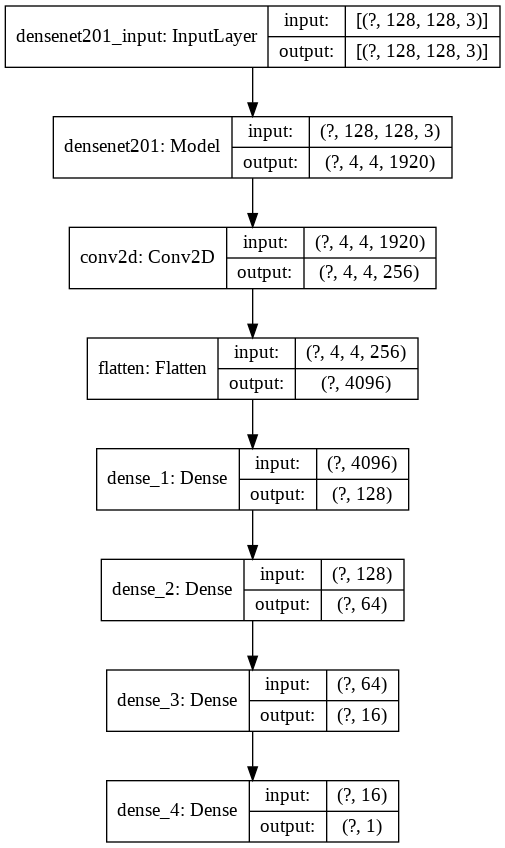

In [0]:
sgd = tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.9)
def loss_fn(y_true, y_pred):
  loss = tf.keras.losses.binary_crossentropy(y_true, y_pred, from_logits=True)
  return loss

model.compile(optimizer=sgd, loss=loss_fn,
              metrics=['accuracy'])

tf.keras.utils.plot_model(model, show_shapes=True)

## Load model

In [0]:
import os
checkpoint_path = 'model_tumor_level1.h5' # only this file is available


checkpoint_url = "https://storage.googleapis.com/dl4cv1445/ADL/model_tumor_level1.h5"

# Download the whole slide image
if not os.path.exists(checkpoint_path):
  !curl -O $checkpoint_url


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 74.5M  100 74.5M    0     0   136M      0 --:--:-- --:--:-- --:--:--  136M


In [0]:
model.load_weights('model_tumor_level1.h5')

## Prediction visualization

In [0]:
IMG_SIZE = 128
def load_and_preprocess_image_test(path_img, path_label):
  img_tensor = tf.io.read_file(path_img)
  input_image = tf.image.decode_jpeg(img_tensor, channels=3)
  input_image = tf.image.resize(input_image, [IMG_SIZE, IMG_SIZE])

  label_tensor = tf.io.read_file(path_label)
  # input_mask = tf.image.decode_image(label_tensor)
  input_mask = tf.image.decode_jpeg(label_tensor, channels=1)
  input_mask = tf.image.resize(input_mask, [IMG_SIZE, IMG_SIZE])
  
  input_image /= 255.0
  # input_mask /= 255.0
  return input_image, input_mask

In [0]:
from __future__ import absolute_import, division, print_function, unicode_literals

from IPython.display import clear_output
import matplotlib.pyplot as plt

### 001

In [0]:
import os
dataset_path = 'level1_001.zip' # only this file is available


dataset_url = "https://storage.googleapis.com/dl4cv1445/level1_001.zip"

# Download the whole slide image
if not os.path.exists(dataset_path):
  !curl -O $dataset_url


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   216  100   216    0     0    782      0 --:--:-- --:--:-- --:--:--   782


#### True mask 001

In [0]:
!unzip level1_001.zip

Archive:  level1_001.zip
  End-of-central-directory signature not found.  Either this file is not
  a zipfile, or it constitutes one disk of a multi-part archive.  In the
  latter case the central directory and zipfile comment will be found on
  the last disk(s) of this archive.
unzip:  cannot find zipfile directory in one of level1_001.zip or
        level1_001.zip.zip, and cannot find level1_001.zip.ZIP, period.


In [0]:
mm = 16
nn = 16
import cv2
x_offset = 486
y_offset = 272
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dt/001_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "dt/001_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))


    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0.0, vmax=1.0, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    # mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Predicted mask 001

In [0]:
mm = 16
nn = 16
import cv2
x_offset = 486
y_offset = 272
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16, 16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dt/001_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "dt/001_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5:
      mask_img = np.ones((128,128,1))
    else:
      mask_img = np.zeros((128,128,1))
    mask_img = mask_img[...,0]

    # mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Accuracy

In [0]:
def find_cancer_pixels(image):
    indices = np.where(image>0)
    # print(len(indices[0]))
    # percent_cancer = len(indices[0]) / float(image.shape[0] * image.shape[0]) * 100
    if len(indices[0]) > 0:
      return True
    else:
      return False


overall = 0
overlap = 0

mm = 16
nn = 16
import cv2
x_offset = 486
y_offset = 272
WIDTH = 128
HEIGHT = 128


for i in range(mm):
  for j in range(nn):
    try:
      img_path = "dt/001_" + str(x_offset+i) + "_" + str(y_offset+j) + ".jpg"
      label_path = "dt/001_" + str(x_offset+i) + "_" + str(y_offset+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5 and find_cancer_pixels(mask_img):
      overlap += 1
    if pred_mask[0][0] > 0.5 or find_cancer_pixels(mask_img):
      overall += 1
    mask_img = mask_img[...,0]


    mask_img = mask_img * 255.0

print('Accuracy: ', overlap * 100.0 / overall)

Accuracy:  49.31506849315068


### 091

In [0]:
import os
dataset_path = 'level1_091.zip' # only this file is available


dataset_url = "https://storage.googleapis.com/dl4cv1445/level1_091.zip"

# Download the whole slide image
if not os.path.exists(dataset_path):
  !curl -O $dataset_url


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  175M  100  175M    0     0   138M      0  0:00:01  0:00:01 --:--:--  138M


In [0]:
!unzip level1_091.zip

#### True mask 091

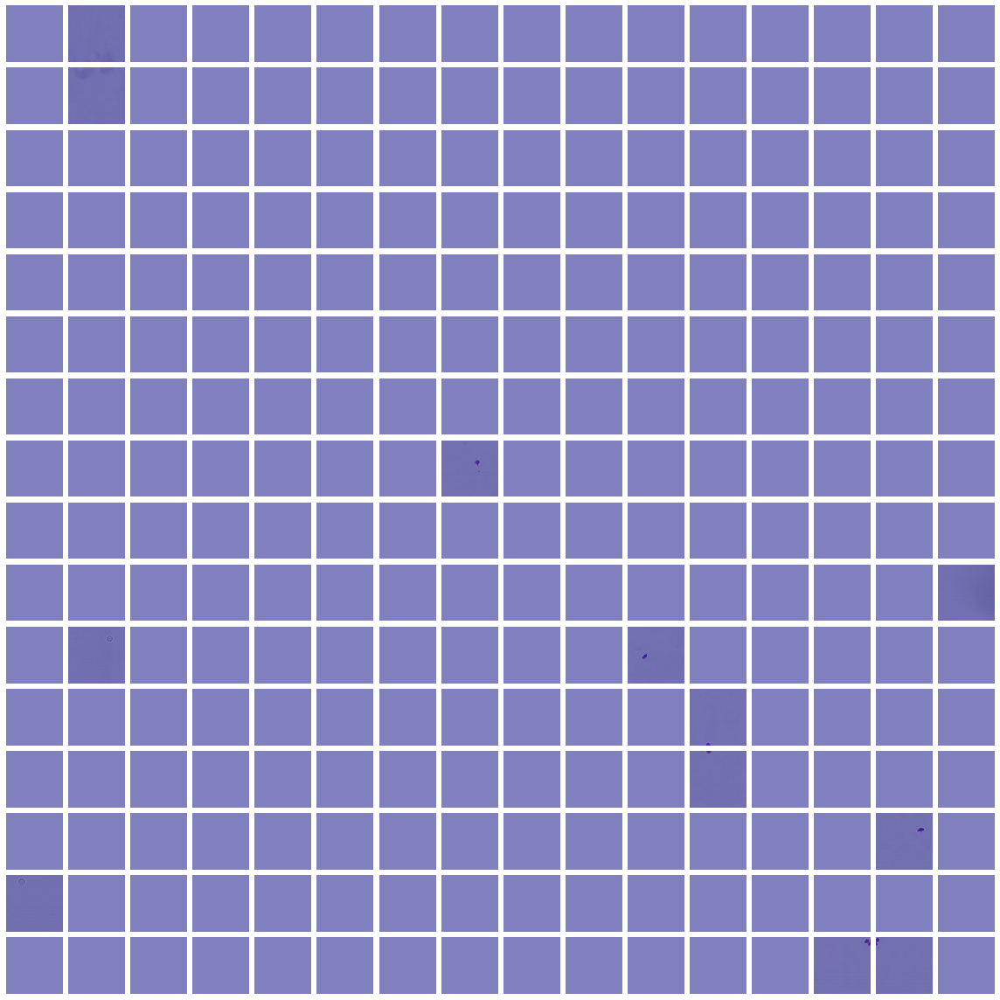

In [0]:
mm = 16
nn = 16
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level1_091/dt091/091_" + str(i) + "_" + str(60+j) + ".jpg"
      label_path = "level1_091/dt091/091_" + str(i) + "_" + str(60+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    # img_path = "dt/001_" + str(i) + "_" + str(j) + ".jpg"
    # label_path = "dt/001_" + str(i) + "_" + str(j) + "_mask.jpg"
    # slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0.0, vmax=1.0, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    # mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Predicted mask 091

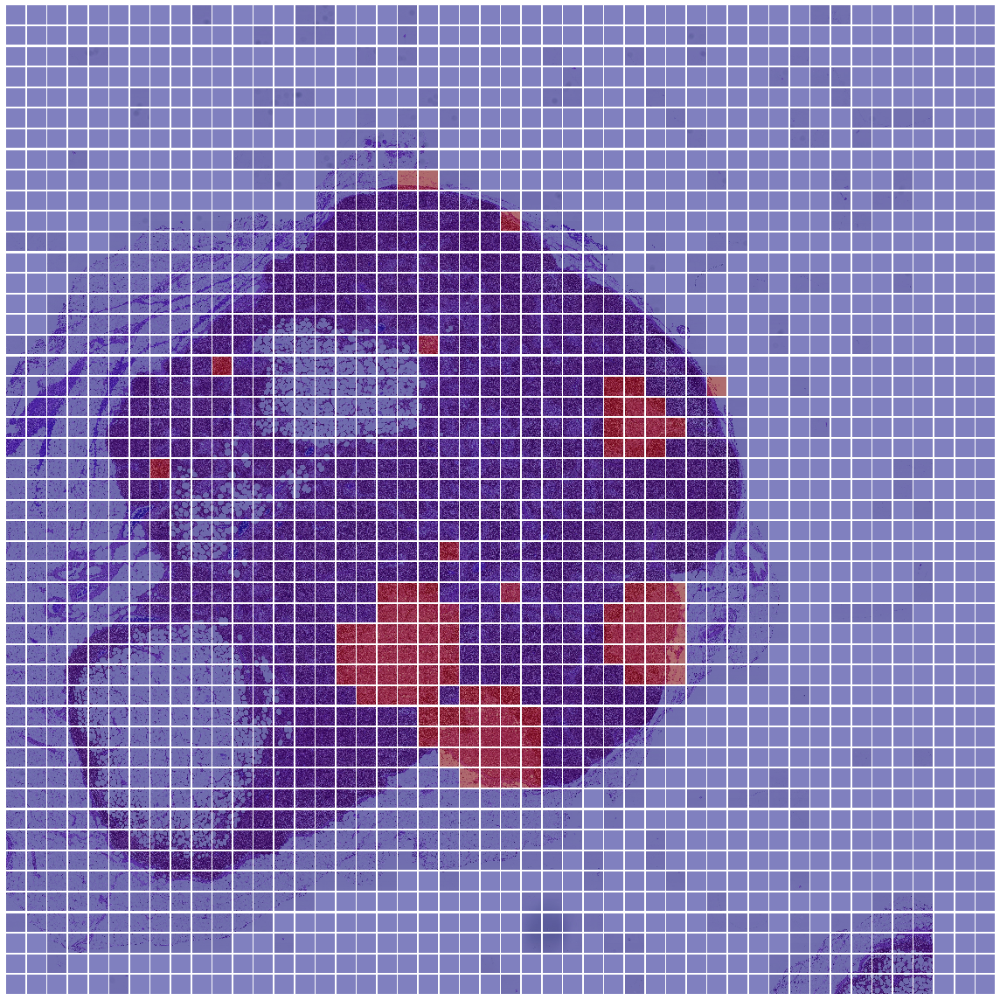

In [0]:
mm = 48
nn = 48
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3/dt091/091_" + str(i) + "_" + str(15+j) + ".jpg"
      label_path = "level3/dt091/091_" + str(i) + "_" + str(15+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5:
      mask_img = np.ones((128,128,1))
    else:
      mask_img = np.zeros((128,128,1))
    mask_img = mask_img[...,0]

    # mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

### 016

In [0]:
import os
dataset_path = 'level3_016.zip' # only this file is available


dataset_url = "https://storage.googleapis.com/dl4cv1445/level3_016.zip"

# Download the whole slide image
if not os.path.exists(dataset_path):
  !curl -O $dataset_url


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 25.2M  100 25.2M    0     0  16.1M      0  0:00:01  0:00:01 --:--:-- 16.1M


In [0]:
!unzip level3_016.zip

#### True mask 016

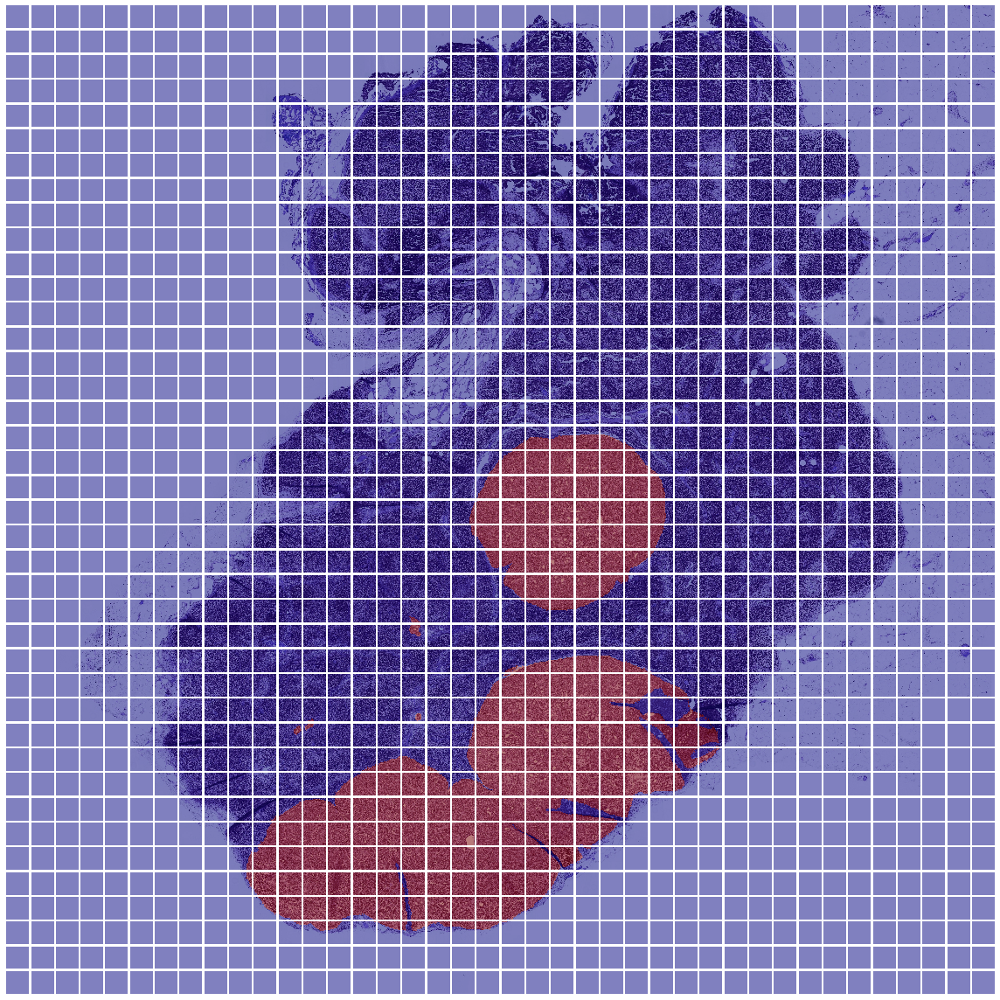

In [0]:
mm = 40
nn = 40
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + ".jpg"
      label_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))

    

    mask_img = mask_img[...,0]
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0.0, vmax=1.0, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    # mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()

#### Predicted mask 016

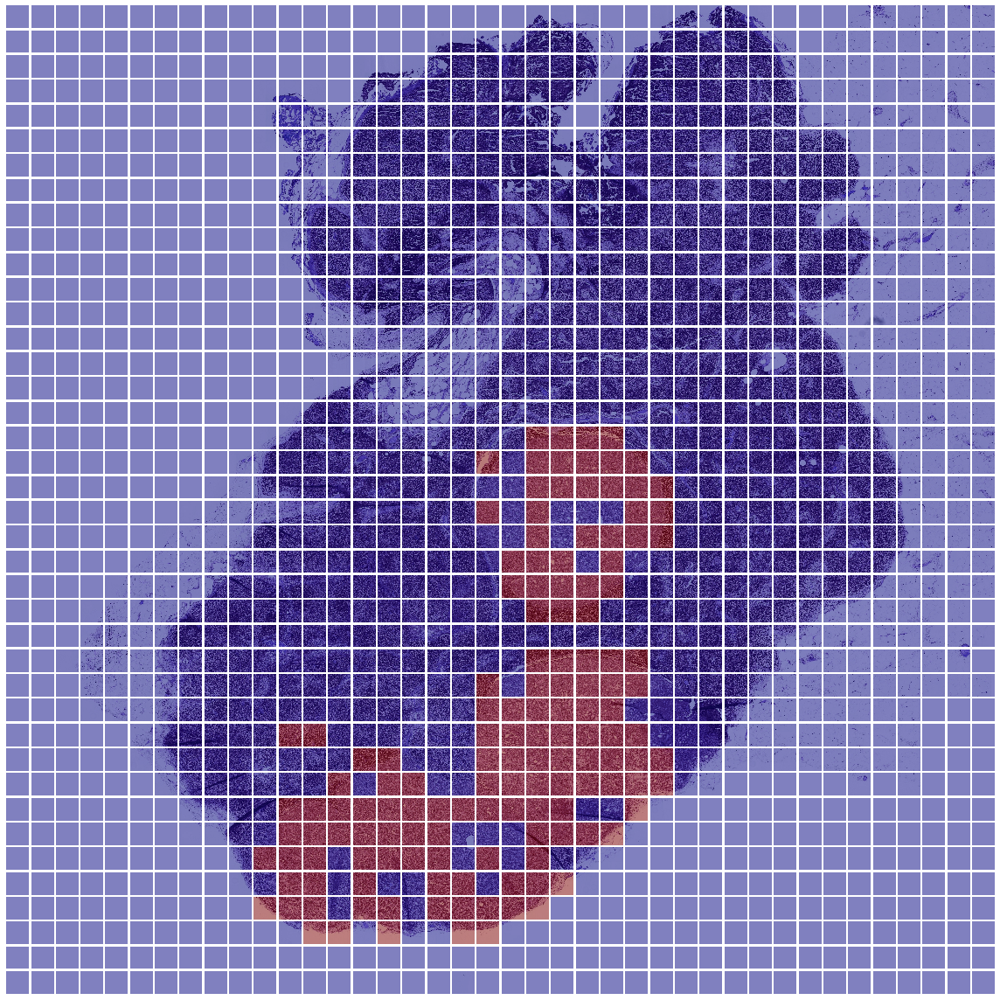

In [0]:
mm = 40
nn = 40
import cv2
WIDTH = 128
HEIGHT = 128

fig, axes = plt.subplots(mm, nn, figsize=(16,16))
idd = []

for i in range(mm):
  for j in range(nn):
    try:
      img_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + ".jpg"
      label_path = "level3_016/dt016/016_" + str(128+i) + "_" + str(18+j) + "_mask.jpg"
      slide_image, mask_img = load_and_preprocess_image_test(img_path, label_path)
    except:
      slide_image, mask_img = np.ones((128,128,3)), np.zeros((128,128,1))
    # print(slide_image.shape)
    # mask_img = mask_img * 255.0

    image = tf.expand_dims(slide_image, 0)
    # print(image.shape)
    pred_mask = model.predict(image)
    # print(pred_mask)
    if pred_mask[0][0] > 0.5:
      mask_img = np.ones((128,128,1))
    else:
      mask_img = np.zeros((128,128,1))
    mask_img = mask_img[...,0]

    # mask_img = pred_mask
    # print(slide_image.shape)
    axes[i][j].imshow(slide_image)
    # axes[j][i].axis('off')
    axes[i][j].imshow(mask_img, vmin=0, vmax=1, cmap='jet', alpha=0.5)
    axes[i][j].axis('off')

    mask_img = mask_img * 255.0
    # cv2.imwrite("dt/" + "091_%d_%d.jpg" % (i, j), slide_image)
    # cv2.imwrite("dt/" + "091_%d_%d_mask.jpg" % (i, j), mask_img)

    idd.append(str(i) + '_' + str(j))

plt.tight_layout()
plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
plt.show()